# Notebook for model training

### Training Flow

Load Training Data:
- Load set of input data and label files
- Prefilter positive set only to rule out heavily-masked patches
- Create train/test set
- Define augmentation parameters

Train Model:
- Define model architecture
- Compile model
- Train and evaluate model
- Save model

In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
from datetime import date
from datetime import datetime
import time
import os
import pickle
import sys

import json

import pandas as pd
import io
from contextlib import redirect_stdout
import re
import matplotlib.pyplot as plt
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.utils import shuffle
from tensorflow import keras
from tensorflow.keras.applications import MobileNet
from tensorflow.keras.models import Model

from keras.layers import Input, Dense, Flatten, Dropout, Conv2D
from keras.models import Model
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.optimizers import Adam
from tqdm.notebook import tqdm

parent_dir = os.path.split(os.getcwd())[0]
if parent_dir not in sys.path:
    sys.path.insert(0, parent_dir)

from scripts import dl_utils
from scripts import viz_tools
from scripts import models

import gc
from tensorflow.keras import backend as K

2024-09-08 15:31:25.912545: I tensorflow/core/util/port.cc:113] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2024-09-08 15:31:26.174237: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-09-08 15:31:26.174282: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-09-08 15:31:26.188353: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-09-08 15:31:26.232378: I tensorflow/core/platform/cpu_feature_guar

## Open Data

In [3]:
resolution = 48

data_file_names = [ 
                    'amazonas_2020_thresh_0.5_2_negatives',
                    'amazonas_2020_thresh_0.8_sumbsample_3_positives',
                    'MinesPos2018-2020Sentinel_points',
                    'bolivar_2020_thresh_0.8_sumbsample_5_positives',
                    'full_amazon_v9_negatives',
                    'v2.4_amazon_positives',
                    'v2.6_amazon_thresh_0.8_negatives',
                    'v2.0_bolivar_negatives',
                    'riverbank_negatives',
                    'v2.1_bolivar_positives',
                    'bolivar_2020_thresh_0.8_1_negatives', 
                    'v2.1.1_bolivar_negatives',
                    'v2.1_bolivar_positives_v2',
              ]

start_dates = ['2019-01-01']
end_dates = ['2020-01-01']
dates = [f'{sd}_{ed}' for sd,ed in zip(start_dates, end_dates)]
data_files = [f'{fn}_{sd}_{ed}_patch_arrays.pkl' for fn in data_file_names for sd, ed in zip(start_dates, end_dates)]
label_files = [f.split('s.pkl')[0] + '_labels.pkl' for f in data_files]

data_files += [
    "amazonas_2020_thresh_0.5_2_negatives_2019-01-01_2020-01-01_patch_arrays.pkl",
    "amazonas_2020_thresh_0.8_sumbsample_3_positives_2019-01-01_2020-01-01_patch_arrays.pkl",
    "MinesPos2018-2020Sentinel_points_2019-01-01_2020-01-01_patch_arrays.pkl",
    "bolivar_2020_thresh_0.8_sumbsample_5_positives_2019-01-01_2020-01-01_patch_arrays.pkl",
    "full_amazon_v9_negatives_2019-01-01_2020-01-01_patch_arrays.pkl",
    "v2.4_amazon_positives_2019-01-01_2020-01-01_patch_arrays.pkl",
    "v2.6_amazon_thresh_0.8_negatives_2019-01-01_2020-01-01_patch_arrays.pkl",
    "v2.0_bolivar_negatives_2019-01-01_2020-01-01_patch_arrays.pkl",
    "riverbank_negatives_2019-01-01_2020-01-01_patch_arrays.pkl",
    "v2.1_bolivar_positives_2019-01-01_2020-01-01_patch_arrays.pkl",
    "bolivar_2020_thresh_0.8_1_negatives_2019-01-01_2020-01-01_patch_arrays.pkl",
    "v2.1.1_bolivar_negatives_2019-01-01_2020-01-01_patch_arrays.pkl",
    "v2.1_bolivar_positives_v2_2019-01-01_2020-01-01_patch_arrays.pkl"
    ]

label_files += [
    "amazonas_2020_thresh_0.5_2_negatives_2019-01-01_2020-01-01_patch_array_labels.pkl",
    "amazonas_2020_thresh_0.8_sumbsample_3_positives_2019-01-01_2020-01-01_patch_array_labels.pkl",
    "MinesPos2018-2020Sentinel_points_2019-01-01_2020-01-01_patch_array_labels.pkl",
    "bolivar_2020_thresh_0.8_sumbsample_5_positives_2019-01-01_2020-01-01_patch_array_labels.pkl",
    "full_amazon_v9_negatives_2019-01-01_2020-01-01_patch_array_labels.pkl",
    "v2.4_amazon_positives_2019-01-01_2020-01-01_patch_array_labels.pkl",
    "v2.6_amazon_thresh_0.8_negatives_2019-01-01_2020-01-01_patch_array_labels.pkl",
    "v2.0_bolivar_negatives_2019-01-01_2020-01-01_patch_array_labels.pkl",
    "riverbank_negatives_2019-01-01_2020-01-01_patch_array_labels.pkl",
    "v2.1_bolivar_positives_2019-01-01_2020-01-01_patch_array_labels.pkl",
    "bolivar_2020_thresh_0.8_1_negatives_2019-01-01_2020-01-01_patch_array_labels.pkl",
    "v2.1.1_bolivar_negatives_2019-01-01_2020-01-01_patch_array_labels.pkl",
    "v2.1_bolivar_positives_v2_2019-01-01_2020-01-01_patch_array_labels.pkl"
 
]

patches = []
labels = []

data_dir = os.path.join('..', 'data', 'training_data', f"{resolution}_px")

for data, label in tqdm(zip(data_files, label_files), total=len(data_files)):
    with open(os.path.join(data_dir, data), 'rb') as f:
        data = pickle.load(f)
        for elem in data:
            #patch = dl_utils.pad_patch(elem, resolution)
            patches.append(elem)
    with open(os.path.join(data_dir, label), 'rb') as f:
        label = pickle.load(f)
        labels = np.concatenate((labels, label))

patches = np.array(patches)
negative_patches = patches[labels == 0]
positive_patches = patches[labels == 1]

print(len(patches), "samples loaded")
print(sum(labels == 1), "positive samples")
print(sum(labels == 0), "negative samples")

  0%|          | 0/26 [00:00<?, ?it/s]

4516 samples loaded
1560 positive samples
2956 negative samples


  0%|          | 0/64 [00:00<?, ?it/s]

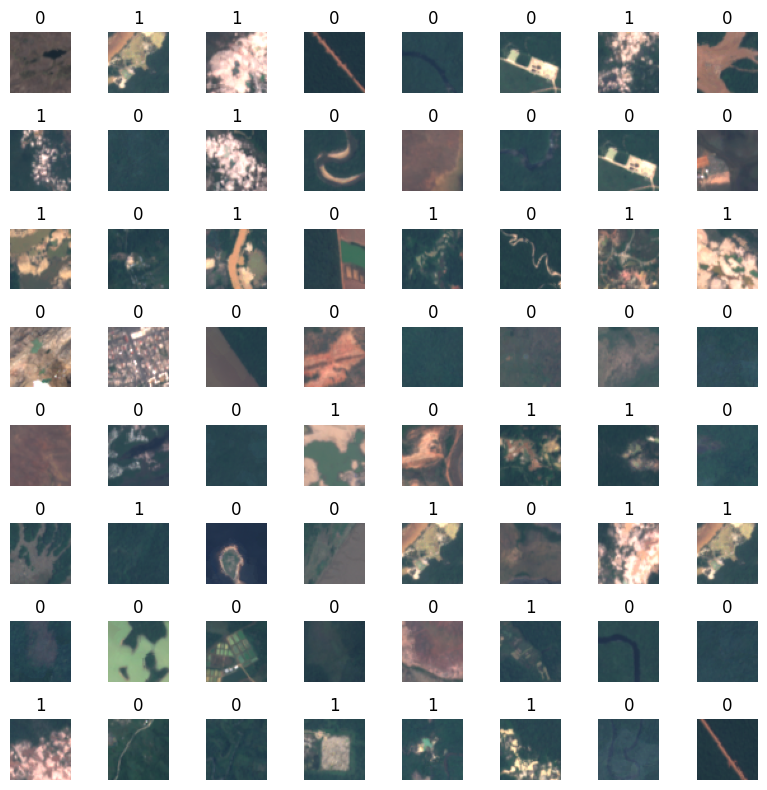

In [4]:
num_samples = 64
indices = np.random.randint(0, len(patches), num_samples)
viz_tools.plot_image_grid(patches[indices], labels=[int(label) for label in labels[indices]])

In [5]:
def filter_black(data, mask_limit=0.1, return_rejects=False):
    masked_fraction = np.array([np.sum(np.mean(patch, axis=-1) < 10) / np.size(np.mean(patch, axis=-1)) for patch in data])
    filtered_data = data[masked_fraction < mask_limit]
    print(f"{len(filtered_data) / len(data) :.1%} of data below brightness limit")
    if return_rejects:
        rejected_data = data[masked_fraction >= mask_limit]
        return filtered_data, rejected_data
    else:
        return filtered_data

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..1.7198333333333333].


100.0% of data below brightness limit


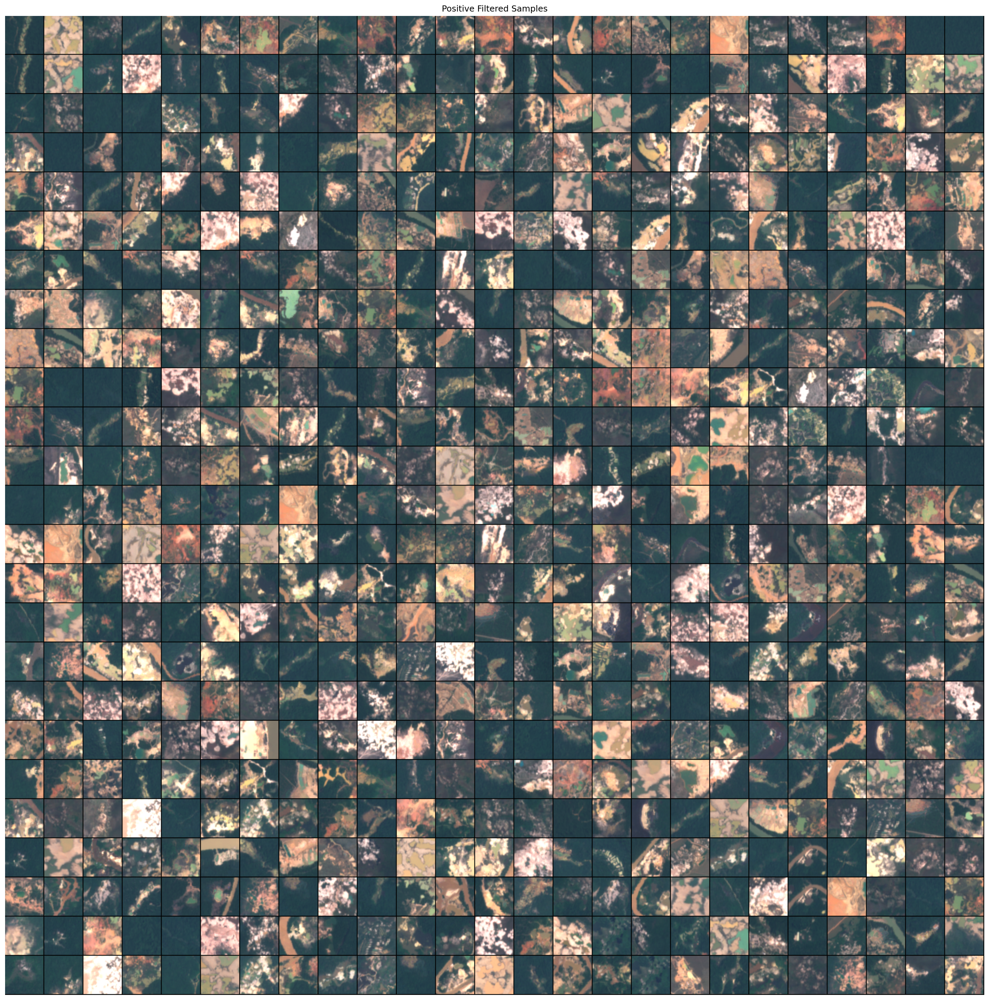

In [6]:
# Filter positive pixels that are masked beyond a threshold. Don't want to give positive examples of cloud-masked patches
filtered_positives, positive_rejects = filter_black(positive_patches, mask_limit = 0.1, return_rejects=True)
if len(positive_rejects) > 0:
    num_samples = 16**2
    if len(positive_rejects) < num_samples:
        num_samples = len(positive_rejects)
    indices = np.random.randint(0, len(positive_rejects), num_samples)
    viz_tools.plot_numpy_grid(positive_rejects[indices,:,:,3:0:-1] / 3000)
    plt.title("Positive Masked Rejects")
    plt.show()

num_samples = 25 ** 2
indices = np.random.randint(0, len(filtered_positives), num_samples)
fig = viz_tools.plot_numpy_grid(filtered_positives[indices,:,:,3:0:-1] / 3000)
plt.title('Positive Filtered Samples')
plt.show()

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [0.0..3.4073333333333333].


100.0% of data below brightness limit


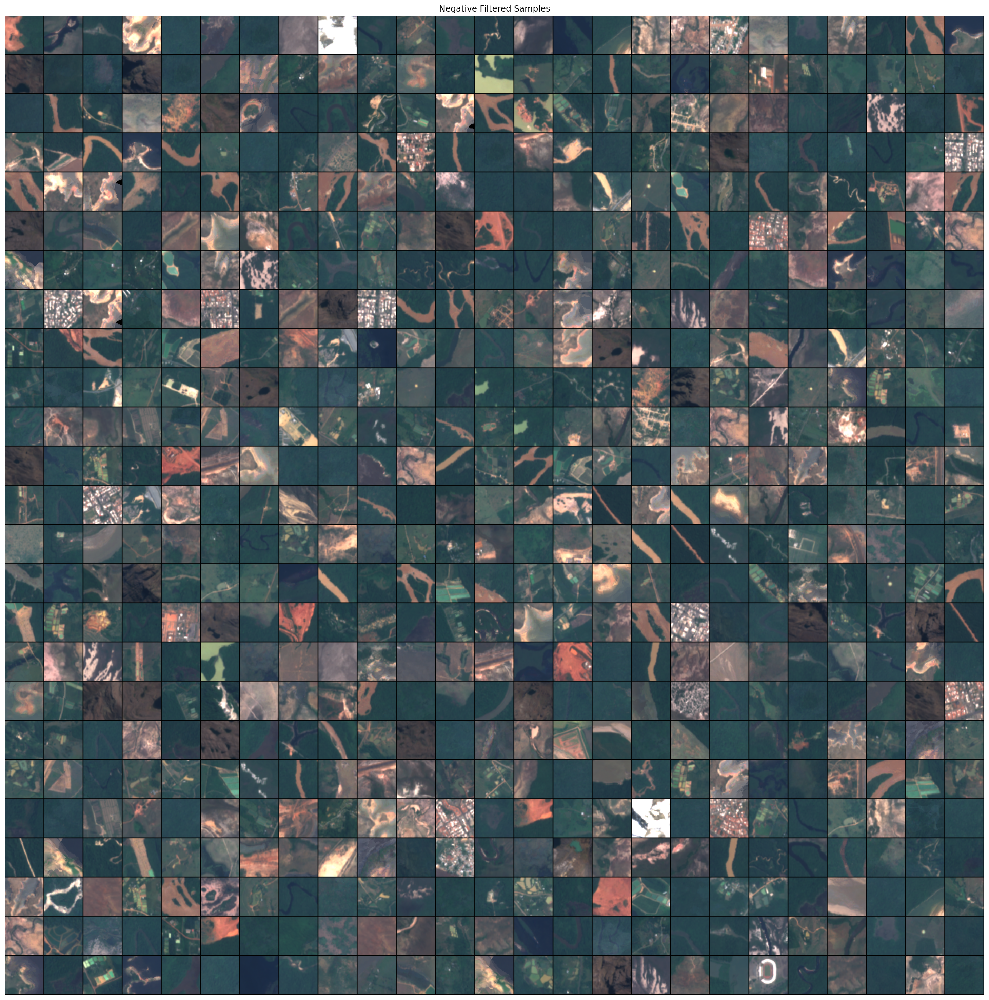

In [7]:
filtered_negatives, negative_rejects = filter_black(negative_patches, mask_limit = 0.6, return_rejects=True)
if len(negative_rejects) > 0:
    num_samples = 16**2
    if len(positive_rejects) < num_samples:
        num_samples = len(positive_rejects)
    indices = np.random.randint(0, len(negative_rejects), num_samples)
    viz_tools.plot_numpy_grid(negative_rejects[indices,:,:,3:0:-1] / 3000)
    plt.title("Negative Mask Rejects")
    plt.show()

num_samples = 25 ** 2
indices = np.random.randint(0, len(filtered_negatives), num_samples)
fig = viz_tools.plot_numpy_grid(filtered_negatives[indices,:,:,3:0:-1] / 3000)
plt.title('Negative Filtered Samples')
plt.show()

## Prepare Data for Training

In [8]:
#for RGBIR, x = normalize(np.copy(images[:,:,:,[1,2,3,8]]))
x = np.concatenate((filtered_negatives, filtered_positives))
y = np.concatenate((np.zeros(len(filtered_negatives)), np.ones(len(filtered_positives))))
x, y = shuffle(x, y, random_state=33)

/home/raulpg/anaconda3/envs/tfm_tf/lib/python3.11/site-packages/keras/src/preprocessing/image.py:766: UserWarning: NumpyArrayIterator is set to use the data format convention "channels_last" (channels on axis 3), i.e. expected either 1, 3, or 4 channels on axis 3. However, it was passed an array with shape (4516, 48, 48, 12) (12 channels).
  warnings.warn(


  0%|          | 0/64 [00:00<?, ?it/s]

<Figure size 1800x1800 with 0 Axes>

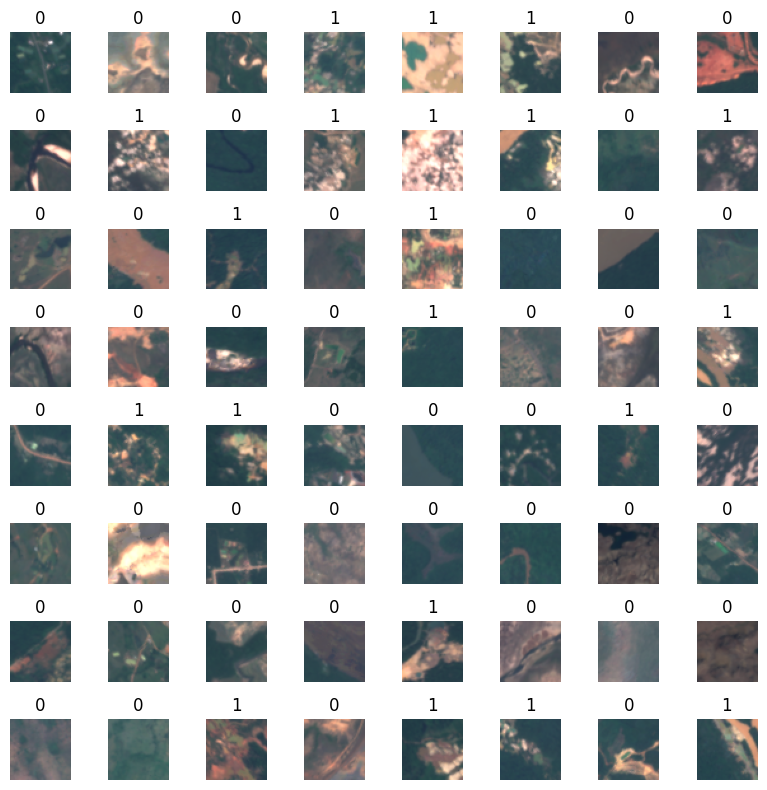

In [9]:
augmentation_parameters = {
    'featurewise_center': False,
    'rotation_range': 360,
    'width_shift_range': [0.9, 1.1],
    'height_shift_range': [0.9, 1.1],
    'shear_range': 10,
    'zoom_range': [0.9, 1.1],
    'vertical_flip': True,
    'horizontal_flip': True,
    # Fill options: "constant", "nearest", "reflect" or "wrap"
    'fill_mode': 'reflect'
}

datagen = ImageDataGenerator(**augmentation_parameters)


plt.figure(figsize=(12,12), facecolor=(1,1,1), dpi=150)
aug_img, aug_labels = datagen.flow(x, y, batch_size=64).next()
viz_tools.plot_image_grid(aug_img, labels=[int(l) for l in aug_labels], norm=True);


In [10]:
x_norm = np.clip(np.array(x.astype("float32") / 10000), 0, 1)

Seleccionamos el 10% del dataset para realizar el testeo de los modelos

In [11]:
dataset_size = len(y)
test_partition = int(dataset_size*0.1)

num_positive_samples_test = sum(y[:test_partition]==1)
num_negative_samples_test = sum(y[:test_partition]==0)

print(f"Número de clases positivas en el dataset de test {num_positive_samples_test}, número de clases negativas {num_negative_samples_test}")

x_norm = x_norm[:test_partition]
y = y[:test_partition]

Número de clases positivas en el dataset de test 150, número de clases negativas 301


# Seleccionar mejor modelo y parámetros de entre todas las pruebas realizadas

In [12]:
path_best_models = f"../notebooks/best_models"
paths_best_models = [path for path in os.listdir(path_best_models) if "modelo_y_parametros" not in path]

In [13]:
df_scratch = pd.DataFrame()
df_scratch_modified = pd.DataFrame()
df_vgg = pd.DataFrame()
df_mobile_net = pd.DataFrame()

for i,model in enumerate(["scratch_original","scratch_modified","vgg16","mobile_net"]): 
    df_aux = pd.DataFrame()
    path_aux = ""
    for path in paths_best_models:
        for file in os.listdir(f"{path_best_models}/{path}"):
            if re.search(rf"{model}.*\.csv",file) is not None:
                df_aux, path_aux = dl_utils.compare_best_results(pd.read_csv(f"{path_best_models}/{path}/{file}"),df_aux,f"{path_best_models}/{path}/{file}",path_aux)
    if i == 0:
        df_scratch = df_aux
        scratch_best_path = path_aux
        scratch_dir = "/".join(scratch_best_path.split("/")[:-1])
    elif i== 1:
        df_scratch_modified = df_aux
        scratch_modified_best_path = path_aux
        scratch_modified_dir = "/".join(scratch_modified_best_path.split("/")[:-1])
    elif i == 2:
        df_vgg = df_aux
        vgg_best_path = path_aux
        vgg_dir = "/".join(vgg_best_path.split("/")[:-1])
    else:
        df_mobile_net = df_aux
        mobile_net_best_path = path_aux
        mobile_net_dir = "/".join(mobile_net_best_path.split("/")[:-1])

# Mejores resultados para el modelo original sin cambios en los hiperparámetros
path_dir_original  = [f"{path_best_models}/{path}" for path in os.listdir(path_best_models) if "modelo_y_parametros_originales" in path][0]
best_original_path = [ f"{path_dir_original}/{path_csv}" for path_csv in os.listdir(path_dir_original) if "csv" in path_csv][0]
df_original = pd.read_csv(best_original_path)
original_dir = "/".join(best_original_path.split("/")[:-1])

## Modelo original con parámetros originales

../notebooks/best_models/modelo_y_parametros_originales_2024-09-07_10-09


,index,precision,recall,f1-score,support
0,0.0,1.00,0.93,0.96,301
1,1.0,0.88,0.99,0.93,150
2,accuracy,NaN,NaN,0.95,451
3,macro avg,0.94,0.96,0.95,451
4,weighted avg,0.96,0.95,0.95,451


Los hiperparámetros empleados son:
{
     "class_weight": {
          "0": 1,
          "1": 1
     },
     "batch_size": 32,
     "epochs": 160,
     "test_size": 0.3,
     "semilla": 78
}

El número de épocas totales empleadas para el entrenamiento del modelo son 	--> 160 épocas.

Tiempo total empleado en el entrenamiento --> 420.12290835380554 segundos 



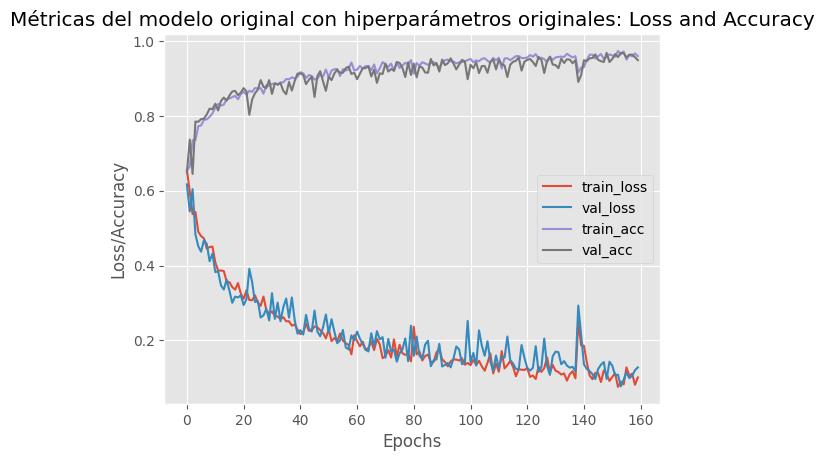


Número de parámetros entrenables

Total params: 116577 (455.38 KB)
Trainable params: 116577 (455.38 KB)
Non-trainable params: 0 (0.00 Byte)
None


In [27]:
print(original_dir)
display(df_original)
hiperparams_modelo_y_parametros_originales,best_modelo_y_parametros_originales_results = dl_utils.load_hiperparams_and_results(original_dir,"modelo_y_parametros_originales")
print(f"Los hiperparámetros empleados son:\n{json.dumps(hiperparams_modelo_y_parametros_originales[0],indent=5)}\n")
print(f"El número de épocas totales empleadas para el entrenamiento del modelo son \t--> {len(best_modelo_y_parametros_originales_results.epoch)} épocas.\n")
print(f"Tiempo total empleado en el entrenamiento --> {hiperparams_modelo_y_parametros_originales[-1]} segundos \n")
dl_utils.grafica_accuracy(best_modelo_y_parametros_originales_results,"del modelo original con hiperparámetros originales")
print(f"\nNúmero de parámetros entrenables\n")
print(dl_utils.get_total_params(models.scratch_original_model(x.shape[1:])))

## Original from scratch model con cambios en los hiperparámetros
Se reduce el batch size de 32 a 16.

../notebooks/best_models/split_30_modified_2024-09-08_08-51


,index,precision,recall,f1-score,support
0,0.0,0.98,0.97,0.98,301
1,1.0,0.95,0.97,0.96,150
2,accuracy,NaN,NaN,0.97,451
3,macro avg,0.97,0.97,0.97,451
4,weighted avg,0.97,0.97,0.97,451


Los hiperparámetros empleados son:
{
     "class_weight": {
          "0": 1.3468634686346863,
          "1": 1.6531365313653137
     },
     "batch_size": 16,
     "epochs": 160,
     "define_callbacks": [
          "reduce_lr",
          "early_stopping",
          "model_checkpoint"
     ],
     "patience_early_stopping": 14,
     "patience_reduce_lr": 8,
     "test_size": 0.3,
     "semilla": 1874
}

El número de épocas totales empleadas para el entrenamiento del modelo son 	--> 160 épocas.

Tiempo total empleado en el entrenamiento --> 609.3504776954651 segundos 



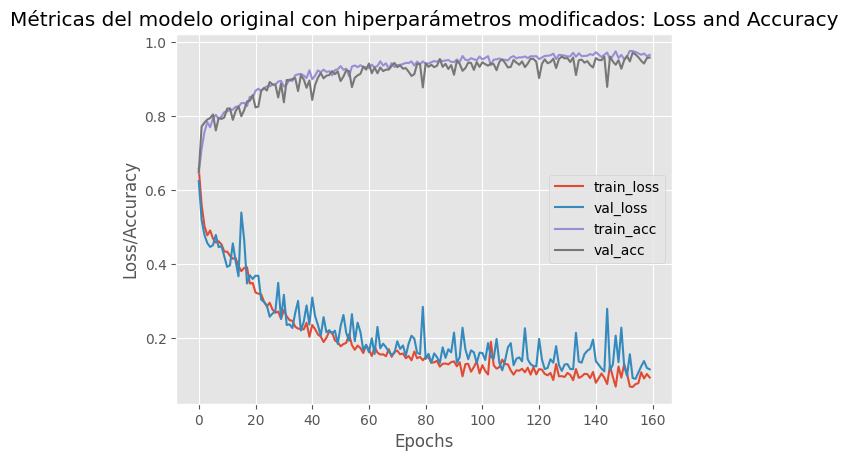


Número de parámetros entrenables

Total params: 116577 (455.38 KB)
Trainable params: 116577 (455.38 KB)
Non-trainable params: 0 (0.00 Byte)
None


In [17]:
print(scratch_dir)
display(df_scratch)
hiperparams_scratch_original,best_scratch_original_results = dl_utils.load_hiperparams_and_results(scratch_dir,"scratch_original")

# Eliminamos los hiperparámetros no empleados por este modelo
# del hiperparams_scratch_original["define_callbacks"]
# del hiperparams_scratch_original["patience_early_stopping"]
# del hiperparams_scratch_original["patience_reduce_lr"]

print(f"Los hiperparámetros empleados son:\n{json.dumps(hiperparams_scratch_original[0],indent=5)}\n")
print(f"El número de épocas totales empleadas para el entrenamiento del modelo son \t--> {len(best_scratch_original_results.epoch)} épocas.\n")
print(f"Tiempo total empleado en el entrenamiento --> {hiperparams_scratch_original[-1]} segundos \n")
dl_utils.grafica_accuracy(best_scratch_original_results,"del modelo original con hiperparámetros modificados")

print(f"\nNúmero de parámetros entrenables\n")
print(dl_utils.get_total_params(models.scratch_original_model(x.shape[1:])))

## From scratch modified model (se aumenta el número de filtros del modelo original)

../notebooks/best_models/split_20_modified_2024-09-07_20-53


,index,precision,recall,f1-score,support
0,0.0,0.99,0.99,0.99,301
1,1.0,0.97,0.99,0.98,150
2,accuracy,NaN,NaN,0.99,451
3,macro avg,0.98,0.99,0.99,451
4,weighted avg,0.99,0.99,0.99,451


Los hiperparámetros empleados son:
{
     "class_weight": {
          "0": 1.3468634686346863,
          "1": 1.6531365313653137
     },
     "batch_size": 32,
     "epochs": 160,
     "define_callbacks": [
          "reduce_lr",
          "early_stopping",
          "model_checkpoint"
     ],
     "patience_early_stopping": 14,
     "patience_reduce_lr": 8,
     "test_size": 0.2,
     "semilla": 59
}

El número de épocas totales empleadas para el entrenamiento del modelo son 	--> 160 épocas.

Tiempo total empleado en el entrenamiento --> 553.5587832927704 segundos 



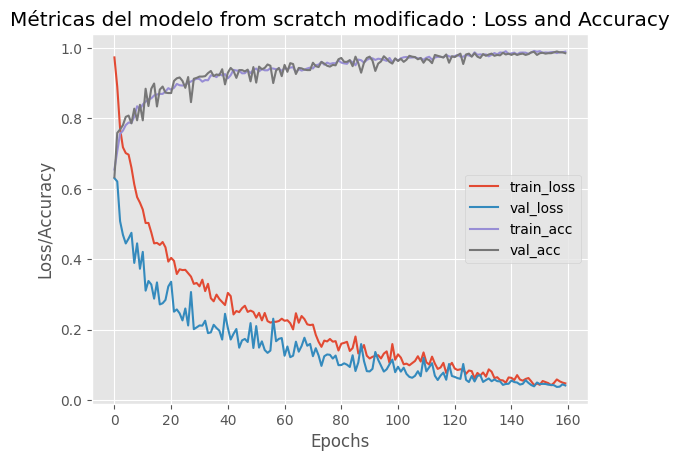


Número de parámetros entrenables

Total params: 1896513 (7.23 MB)
Trainable params: 1896513 (7.23 MB)
Non-trainable params: 0 (0.00 Byte)
None


In [18]:
print(scratch_modified_dir)
display(df_scratch_modified)
hiperparams_scratch_modified,best_scratch_modified_results = dl_utils.load_hiperparams_and_results(scratch_modified_dir,"scratch_modified")

print(f"Los hiperparámetros empleados son:\n{json.dumps(hiperparams_scratch_modified[0],indent=5)}\n")
print(f"El número de épocas totales empleadas para el entrenamiento del modelo son \t--> {len(best_scratch_modified_results.epoch)} épocas.\n")
print(f"Tiempo total empleado en el entrenamiento --> {hiperparams_scratch_modified[-1]} segundos \n")
dl_utils.grafica_accuracy(best_scratch_modified_results,"del modelo from scratch modificado ")

print(f"\nNúmero de parámetros entrenables\n")
print(dl_utils.get_total_params(models.scratch_modified_model(x.shape[1:])))

## Fine-tunning con VGG16

../notebooks/best_models/split_20_modified_2024-09-07_20-53


,index,precision,recall,f1-score,support
0,0.0,1.0,1.0,1.0,301
1,1.0,1.0,1.0,1.0,150
2,accuracy,NaN,NaN,1.0,451
3,macro avg,1.0,1.0,1.0,451
4,weighted avg,1.0,1.0,1.0,451


Los hiperparámetros empleados son:
{
     "class_weight": {
          "0": 1,
          "1": 1
     },
     "batch_size": 32,
     "epochs": 160,
     "define_callbacks": [
          "reduce_lr",
          "early_stopping",
          "model_checkpoint"
     ],
     "patience_early_stopping": 14,
     "patience_reduce_lr": 8,
     "test_size": 0.2,
     "semilla": 350
}

El número de épocas totales empleadas para el entrenamiento del modelo son 	--> 131 épocas.

Tiempo total empleado en el entrenamiento --> 460.84500646591187 segundos 



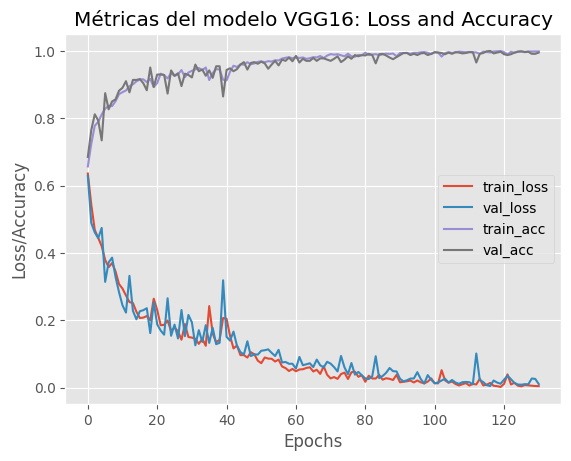


Número de parámetros entrenables

Total params: 15433273 (58.87 MB)
Trainable params: 8353849 (31.87 MB)
Non-trainable params: 7079424 (27.01 MB)
None


In [19]:
print(vgg_dir)
display(df_vgg)
hiperparams_vgg,best_vgg_results = dl_utils.load_hiperparams_and_results(vgg_dir,"vgg16")

print(f"Los hiperparámetros empleados son:\n{json.dumps(hiperparams_vgg[0],indent=5)}\n")
print(f"El número de épocas totales empleadas para el entrenamiento del modelo son \t--> {len(best_vgg_results.epoch)} épocas.\n")
print(f"Tiempo total empleado en el entrenamiento --> {hiperparams_vgg[-1]} segundos \n")
dl_utils.grafica_accuracy(best_vgg_results,"del modelo VGG16")

print(f"\nNúmero de parámetros entrenables\n")
print(dl_utils.get_total_params(models.vgg_16_model(x.shape[1:])))

## Fine-tunning MobileNet

../notebooks/best_models/split_20_2024-09-07_10-44


,index,precision,recall,f1-score,support
0,0.0,0.99,0.99,0.99,301
1,1.0,0.97,0.98,0.98,150
2,accuracy,NaN,NaN,0.98,451
3,macro avg,0.98,0.98,0.98,451
4,weighted avg,0.98,0.98,0.98,451


Los hiperparámetros empleados son:
{
     "class_weight": {
          "0": 1.3468634686346863,
          "1": 1.6531365313653137
     },
     "batch_size": 32,
     "epochs": 160,
     "define_callbacks": [
          "reduce_lr",
          "early_stopping",
          "model_checkpoint"
     ],
     "patience_early_stopping": 7,
     "patience_reduce_lr": 4,
     "test_size": 0.2,
     "semilla": 1671
}

El número de épocas totales empleadas para el entrenamiento del modelo son 	--> 32 épocas.

Tiempo total empleado en el entrenamiento --> 115.92568683624268 segundos.



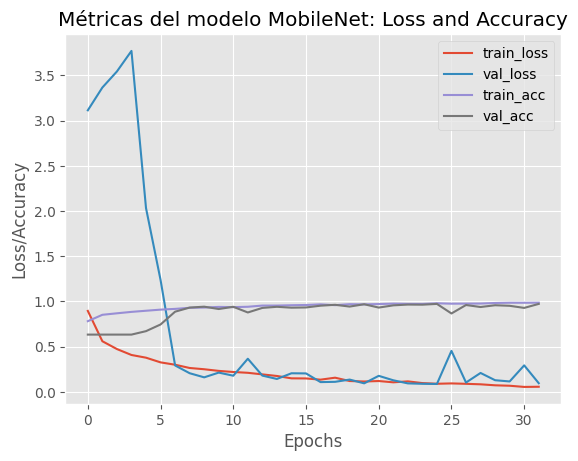


Número de parámetros entrenables

Total params: 12648889 (48.25 MB)
Trainable params: 11616825 (44.31 MB)
Non-trainable params: 1032064 (3.94 MB)
None


In [20]:
print(mobile_net_dir)
display(df_mobile_net)
hiperparams_mobilenet,best_mobilenet_results = dl_utils.load_hiperparams_and_results(mobile_net_dir,"mobile_net")

print(f"Los hiperparámetros empleados son:\n{json.dumps(hiperparams_mobilenet[0],indent=5)}\n")
print(f"El número de épocas totales empleadas para el entrenamiento del modelo son \t--> {len(best_mobilenet_results.epoch)} épocas.\n")
print(f"Tiempo total empleado en el entrenamiento --> {hiperparams_mobilenet[-1]} segundos.\n")
dl_utils.grafica_accuracy(best_mobilenet_results,"del modelo MobileNet")

print(f"\nNúmero de parámetros entrenables\n")
print(dl_utils.get_total_params(models.mobilenet_model(x.shape[1:])))

# Evaluación del desempeño de los modelos:

In [21]:
from tensorflow.keras.models import load_model
input_shape = (48,48,12)

## Modelo original con parámetros originales

In [34]:
tiempo_carga_inferencia = time.time()
modelo_y_parametros_originales = models.scratch_original_model(input_shape)
modelo_y_parametros_originales.load_weights(dl_utils.get_best_model_path(path_dir_original,"modelo_y_parametros_originales",".h5"))
inferencia = time.time()
dl_utils.evaluate_model(modelo_y_parametros_originales,x_norm,y,False,"modelo_y_parametros_originales")
tiempo_inferencia = time.time() - inferencia
tiempo_carga_inferencia = time.time() - tiempo_carga_inferencia
print(f"Tiempo de inferencia: {tiempo_inferencia:.6f} segundos")
print(f"Tiempo de carga + inferencia: {tiempo_carga_inferencia:.6f} segundos")

15/15 [==============================] - 0s 4ms/step
Evaluación del modelo -> modelo_y_parametros_originales
              precision    recall  f1-score   support

         0.0       1.00      0.93      0.96       301
         1.0       0.88      0.99      0.93       150

    accuracy                           0.95       451
   macro avg       0.94      0.96      0.95       451
weighted avg       0.96      0.95      0.95       451

Tiempo de inferencia: 0.162050 segundos
Tiempo de carga + inferencia: 0.256850 segundos


## Original from scratch model con cambios en los hiperparámetros

In [29]:
tiempo_carga_inferencia = time.time()
scratch_original_model = models.scratch_original_model(input_shape)
scratch_original_model.load_weights(dl_utils.get_best_model_path(scratch_dir,"scratch_original",".h5"))
inferencia = time.time()
dl_utils.evaluate_model(scratch_original_model,x_norm,y,False,"scratch_original_model")
tiempo_inferencia = time.time() - inferencia
tiempo_carga_inferencia = time.time() - tiempo_carga_inferencia
print(f"Tiempo de inferencia: {tiempo_inferencia:.6f} segundos")
print(f"Tiempo de carga + inferencia: {tiempo_carga_inferencia:.6f} segundos")

15/15 [==============================] - 0s 7ms/step
Evaluación del modelo -> scratch_original_model
              precision    recall  f1-score   support

         0.0       0.98      0.97      0.98       301
         1.0       0.95      0.97      0.96       150

    accuracy                           0.97       451
   macro avg       0.97      0.97      0.97       451
weighted avg       0.97      0.97      0.97       451

Tiempo de inferencia: 0.228789 segundos
Tiempo de carga + inferencia: 0.322633 segundos


## From scratch modified model (se aumenta el número de filtros del modelo original)

In [30]:
tiempo_carga_inferencia = time.time()
scratch_modified_model = models.scratch_modified_model(input_shape)
scratch_modified_model.load_weights(dl_utils.get_best_model_path(scratch_modified_dir,"scratch_modified",".h5"))
inferencia = time.time()
dl_utils.evaluate_model(scratch_modified_model,x_norm,y,False,"scratch_modified_model")
tiempo_inferencia = time.time() - inferencia
tiempo_carga_inferencia = time.time() - tiempo_carga_inferencia
print(f"Tiempo de inferencia: {tiempo_inferencia:.6f} segundos")
print(f"Tiempo de carga + inferencia: {tiempo_carga_inferencia:.6f} segundos")

15/15 [==============================] - 0s 22ms/step
Evaluación del modelo -> scratch_modified_model
              precision    recall  f1-score   support

         0.0       0.99      0.99      0.99       301
         1.0       0.97      0.99      0.98       150

    accuracy                           0.99       451
   macro avg       0.98      0.99      0.99       451
weighted avg       0.99      0.99      0.99       451

Tiempo de inferencia: 0.453460 segundos
Tiempo de carga + inferencia: 0.565206 segundos


## Fine-tunning con VGG16

In [31]:
tiempo_carga_inferencia = time.time()
vgg16 = models.vgg_16_model(input_shape)
vgg16.load_weights(dl_utils.get_best_model_path(vgg_dir,"vgg16",".h5"))
inferencia = time.time()
dl_utils.evaluate_model(vgg16,x_norm,y,False,"vgg16")
tiempo_inferencia = time.time() - inferencia
tiempo_carga_inferencia = time.time() - tiempo_carga_inferencia
print(f"Tiempo de inferencia: {tiempo_inferencia:.6f} segundos")
print(f"Tiempo de carga + inferencia: {tiempo_carga_inferencia:.6f} segundos")

15/15 [==============================] - 0s 24ms/step
Evaluación del modelo -> vgg16
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00       301
         1.0       1.00      1.00      1.00       150

    accuracy                           1.00       451
   macro avg       1.00      1.00      1.00       451
weighted avg       1.00      1.00      1.00       451

Tiempo de inferencia: 0.458660 segundos
Tiempo de carga + inferencia: 1.052854 segundos


## Fine-tunning MobileNet

In [32]:
tiempo_carga_inferencia = time.time()
mobile_net = models.mobilenet_model(input_shape)
mobile_net.load_weights(dl_utils.get_best_model_path(mobile_net_dir,"mobile_net",".h5"))
inferencia = time.time()
dl_utils.evaluate_model(mobile_net,x_norm,y,False,"mobile_net")
tiempo_inferencia = time.time() - inferencia
tiempo_carga_inferencia = time.time() - tiempo_carga_inferencia
print(f"Tiempo de inferencia: {tiempo_inferencia:.6f} segundos")
print(f"Tiempo de carga + inferencia: {tiempo_carga_inferencia:.6f} segundos")

15/15 [==============================] - 0s 16ms/step
Evaluación del modelo -> mobile_net
              precision    recall  f1-score   support

         0.0       0.99      0.99      0.99       301
         1.0       0.97      0.98      0.98       150

    accuracy                           0.98       451
   macro avg       0.98      0.98      0.98       451
weighted avg       0.98      0.98      0.98       451

Tiempo de inferencia: 0.454935 segundos
Tiempo de carga + inferencia: 1.048461 segundos
